# ODSC TTS Workshop: Brand Voice
Within this notebook you will:
- setup the environment for the TTS solution
- load the interactive logs from the training session of the aligner and spectrogram model
- load, predict and customize the results of the TTS and Vocoder models 

## Environment setup

In [1]:
!git clone https://github.com/as-ideas/TransformerTTS.git

Cloning into 'TransformerTTS'...
remote: Enumerating objects: 56, done.
remote: Counting objects: 100% (56/56), done.
remote: Compressing objects: 100% (42/42), done.
remote: Total 3517 (delta 28), reused 32 (delta 14), pack-reused 3461
Receiving objects: 100% (3517/3517), 21.58 MiB | 22.48 MiB/s, done.
Resolving deltas: 100% (2398/2398), done.


In [2]:
!cd ./TransformerTTS; git checkout vocoding
# Install requirements
!apt-get install -y espeak
!pip install -r TransformerTTS/requirements.txt
!pip install -r TransformerTTS/vocoding/extra_requirements.txt
!pip install praat-parselmouth

Branch 'vocoding' set up to track remote branch 'vocoding' from 'origin'.
Switched to a new branch 'vocoding'
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  espeak-data libespeak1 libportaudio2 libsonic0
The following NEW packages will be installed:
  espeak espeak-data libespeak1 libportaudio2 libsonic0
0 upgraded, 5 newly installed, 0 to remove and 30 not upgraded.
Need to get 1,219 kB of archives.
After this operation, 3,031 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libportaudio2 amd64 19.6.0-1 [64.6 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 libsonic0 amd64 0.2.0-6 [13.4 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 espeak-data amd64 1.48.04+dfsg-5 [934 kB]
Get:4 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libespeak1 amd64 1.48.04+dfsg-5 [145 kB]
Get:5 http://archive.ubunt

In [3]:
!wget https://public-asai-dl-models.s3.eu-central-1.amazonaws.com/hifigan.zip
!wget https://public-asai-dl-models.s3.eu-central-1.amazonaws.com/ljspeech_logs.zip
!unzip -q hifigan.zip
!unzip -q ljspeech_logs.zip;
!mv hifigan/en/* TransformerTTS/vocoding/hifigan/en/
!rm -rf hifigan
!rm *.zip

--2021-03-22 14:12:45--  https://public-asai-dl-models.s3.eu-central-1.amazonaws.com/hifigan.zip
Resolving public-asai-dl-models.s3.eu-central-1.amazonaws.com (public-asai-dl-models.s3.eu-central-1.amazonaws.com)... 52.219.47.148
Connecting to public-asai-dl-models.s3.eu-central-1.amazonaws.com (public-asai-dl-models.s3.eu-central-1.amazonaws.com)|52.219.47.148|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 51874346 (49M) [application/zip]
Saving to: ‘hifigan.zip’

hifigan.zip         100%[===================>]  49.47M  19.8MB/s    in 2.5s    

2021-03-22 14:12:48 (19.8 MB/s) - ‘hifigan.zip’ saved [51874346/51874346]

--2021-03-22 14:12:48--  https://public-asai-dl-models.s3.eu-central-1.amazonaws.com/ljspeech_logs.zip
Resolving public-asai-dl-models.s3.eu-central-1.amazonaws.com (public-asai-dl-models.s3.eu-central-1.amazonaws.com)... 52.219.47.148
Connecting to public-asai-dl-models.s3.eu-central-1.amazonaws.com (public-asai-dl-models.s3.eu-central-1.amazon

## Tensorboard session

In [4]:
%load_ext tensorboard
%tensorboard --logdir ljspeech_logs

<IPython.core.display.Javascript object>

## Models playground

### Load models

In [5]:
cd TransformerTTS

/content/TransformerTTS


In [6]:
# Load pretrained model
from model.factory import tts_ljspeech
from data.audio import Audio
from vocoding.predictors import HiFiGANPredictor
import IPython.display as ipd

tts_model, config = tts_ljspeech()
audio = Audio(config)
vocoder = HiFiGANPredictor.from_folder('vocoding/hifigan/en')

175636480/175635288 [==============================] - 8s 0us/step


### Standard Prediction

In [7]:
out = tts_model.predict('Please, say something.')
mel = out['mel'].numpy().T
# Convert spectrogram to wav (with griffin lim)
wav = audio.reconstruct_waveform(mel)
ipd.Audio(wav, rate=audio.config['sampling_rate'])

In [8]:
# Convert spectrogram to wav using HiFiGAN vocoder
wav = vocoder([mel])[0]
ipd.Audio(wav, rate=audio.config['sampling_rate'])

### Customize pitch and durations

Use praat-parselmouth to analyze the pitch directly from the produced wav

In [9]:
import parselmouth
import librosa
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

def draw_pitch(pitch):
    pitch_values = pitch.selected_array['frequency']
    plt.plot(pitch.xs(), pitch_values, 'o', markersize=5, color='w')
    plt.plot(pitch.xs(), pitch_values, 'o', markersize=2)
    plt.grid(False)
    plt.ylim(0, pitch.ceiling)
    plt.ylabel("fundamental frequency [Hz]")

def draw_spectrogram(spectrogram, dynamic_range=70):
    X, Y = spectrogram.x_grid(), spectrogram.y_grid()
    sg_db = 10 * np.log10(spectrogram.values)
    plt.pcolormesh(X, Y, sg_db, vmin=sg_db.max() - dynamic_range, cmap='afmhot')
    plt.ylim([spectrogram.ymin, spectrogram.ymax])
    plt.xlabel("time [s]")
    plt.ylabel("frequency [Hz]")
  
def display_pitch_wav(wav, sr=22050):
    snd = parselmouth.Sound(wav, sampling_frequency=sr)
    pitch = snd.to_pitch()
    # If desired, pre-emphasize the sound fragment before calculating the spectrogram
    pre_emphasized_snd = snd.copy()
    pre_emphasized_snd.pre_emphasize()
    spectrogram = pre_emphasized_snd.to_spectrogram(window_length=0.03, maximum_frequency=8000)
    plt.figure()
    draw_spectrogram(spectrogram)
    plt.twinx()
    draw_pitch(pitch)
    plt.xlim([snd.xmin, snd.xmax])
    plt.title('Analyzed pitch profile')
    plt.show()

First a normal prediction

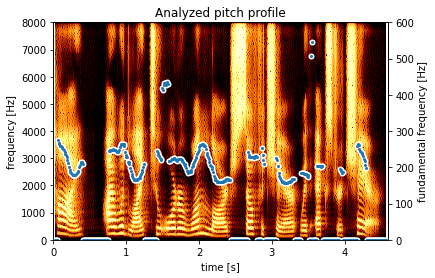

In [10]:
text = "Hi, I would like to order one large sofa chair with extra chair."
out = tts_model.predict(text, encode=True)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))
display_pitch_wav(glim)

Control characters duration and overall speed

In [11]:
text = "Hi, I would like to order one large sofa chair with extra chair."
print('set max durations for comma and spaces to 0')
out = tts_model.predict(text, encode=True, phoneme_max_duration={',': 0., ' ':0.}) # set max durations for comma and spaces to 0
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))

text = "Hi, I would like to order one large sofa chair with extra chair."
print('make it overall slower')
out = tts_model.predict(text, encode=True, speed_regulator=0.9) # make it overall slower
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))

text = "Hi, I would like to order one large sofa chair with extra chair."
print('make it overall slower but 0 durations with comma and spaces')
out = tts_model.predict(text, encode=True, phoneme_max_duration={',': 0., ' ':0.}, speed_regulator=0.9) # make it overall slower but 0 durations with comma and spaces
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))

set max durations for comma and spaces to 0


make it overall slower


make it overall slower but 0 durations with comma and spaces


Predicted pitch profile vs analyzed pitch

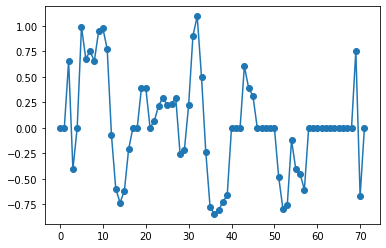

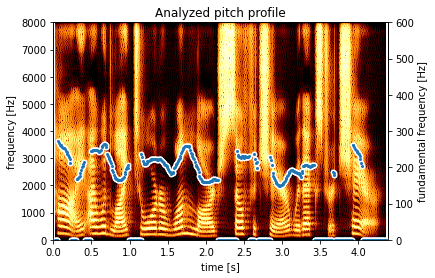

In [12]:
plt.plot(range(len(out['pitch'].numpy()[0])), out['pitch'].numpy()[0], '-o')
plt.show()
display_pitch_wav(glim)

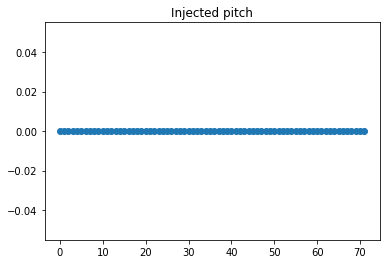

Griffin-lim


HiFiGAN


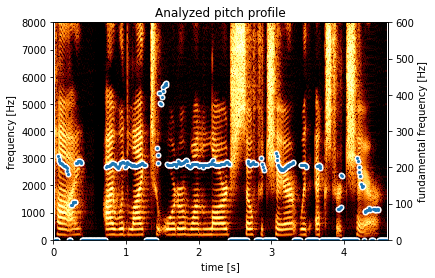

In [13]:
target_pitch = np.zeros_like(out['pitch'].numpy()) # flat pitch
plt.plot(range(len(out['pitch'].numpy()[0])), target_pitch[0], '-o')
plt.title('Injected pitch')
plt.show()
out = tts_model.predict(text, encode=True, phoneme_pitch=target_pitch)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
voc = vocoder([out['mel'].numpy().T])[0]
print('Griffin-lim')
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))
print('HiFiGAN')
ipd.display(ipd.Audio(voc, rate=audio.config['sampling_rate']))
display_pitch_wav(voc)

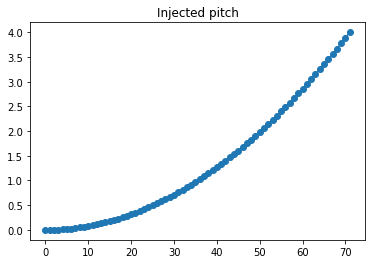

Griffin-lim


HiFiGAN


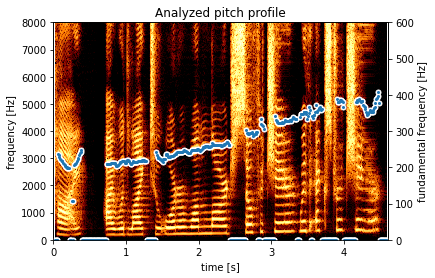

In [14]:
target_pitch = (np.linspace(0,2, len(out['pitch'].numpy()[0]))**2)[None,:,None] # increasing pitch
plt.plot(range(len(out['pitch'].numpy()[0])), target_pitch[0], '-o')
plt.title('Injected pitch')
plt.show()
out = tts_model.predict(text, encode=True, phoneme_pitch=target_pitch)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
voc = vocoder([out['mel'].numpy().T])[0]
print('Griffin-lim')
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))
print('HiFiGAN')
ipd.display(ipd.Audio(voc, rate=audio.config['sampling_rate']))
display_pitch_wav(voc)

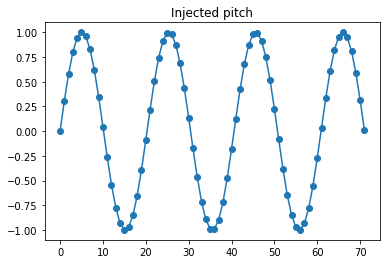

Griffin-lim


HiFiGAN


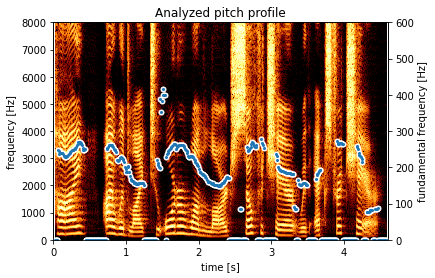

In [15]:
target_pitch = np.sin(np.linspace(0,3.14*7, len(out['pitch'].numpy()[0])))[None,:,None]
plt.plot(range(len(out['pitch'].numpy()[0])), target_pitch[0], '-o')
plt.title('Injected pitch')
plt.show()
out = tts_model.predict(text, encode=True, phoneme_pitch=target_pitch)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
voc = vocoder([out['mel'].numpy().T])[0]
print('Griffin-lim')
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))
print('HiFiGAN')
ipd.display(ipd.Audio(voc, rate=audio.config['sampling_rate']))
display_pitch_wav(voc)

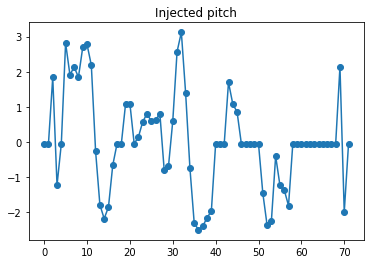

Griffin-lim


HiFiGAN


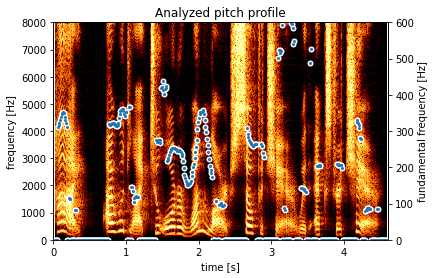

In [16]:
target_pitch = ((out['pitch'].numpy() - out['pitch'].numpy().mean()) * 1.9) + out['pitch'].numpy()
plt.plot(range(len(out['pitch'].numpy()[0])), target_pitch[0], '-o')
plt.title('Injected pitch')
plt.show()
out = tts_model.predict(text, encode=True, phoneme_pitch=target_pitch)
glim = audio.reconstruct_waveform(out['mel'].numpy().T)
voc = vocoder([out['mel'].numpy().T])[0]
print('Griffin-lim')
ipd.display(ipd.Audio(glim, rate=audio.config['sampling_rate']))
print('HiFiGAN')
ipd.display(ipd.Audio(voc, rate=audio.config['sampling_rate']))
display_pitch_wav(voc)